In [40]:
import os
import pandas as pd
import librosa as lr
import librosa.feature as lrf
import librosa.display as lrd
import numpy as np
import sklearn as sk
import matplotlib.pyplot as plt
from tqdm import tqdm


## EDA

In [10]:
SR = 22050 # consistent across every file

signals_path = "/Users/kemalcankucuk/Library/CloudStorage/OneDrive-KocUniversitesi/Okul/4. Sınıf/1. Dönem/COMP411/Project/comp411-project/gtzan_dataset/genres_original"
genre_paths = [os.path.join(signals_path, genre) for genre in os.listdir(signals_path)]

def contains_dsstore(s):
    '''
    Check if the directory contains the MacOS generated file .DS_Store
    '''
    substring = s.split("/")
    return ".DS_Store" in substring

def generate_file_paths(genre_paths):
    file_paths = []
    for genre in genre_paths:
        for file in os.listdir(genre):
            file_path = genre + "/" + file
            file_paths.append(file_path)
    file_paths.sort()
    return file_paths


def load_signals(genre_paths):
    signals = []
    for genre_path in tqdm(genre_paths):
        if contains_dsstore(genre_path):
            continue
        genre = genre_path.split("/")[-1]        
        for file in os.listdir(genre_path):
            file_path = genre_path + "/" + file
            # Skip file system specific paths.
            if contains_dsstore(file_path):
                continue
            signal = lr.load(file_path)[0]
            signals.append([genre, signal])
    signals = sorted(signals, key = lambda list: list[0]) # sort by genre name in descending order
    return np.array(signals)

signals = load_signals(genre_paths)

100%|██████████| 11/11 [02:59<00:00, 16.28s/it]
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:37: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


## Extract Mel-Spectrogram Images

In [44]:
def extract_melspectrogram(signal, filename, plot = False):
    '''
    Extract the melspectrogram image for a given audio signal.
    '''
    img = []
    fig, ax = plt.subplots()
    melspec = lrf.melspectrogram(y=signal, sr=SR)
    melspec_db = lr.power_to_db(melspec, ref=np.max)
    xlabel = "Time" if plot else None
    ylabel = "Mel" if plot else None
    ax.axes.get_xaxis().set_visible(plot)
    ax.axes.get_yaxis().set_visible(plot)
    ax.set_frame_on(plot)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    if plot:
        lrd.specshow(melspec_db, y_axis='mel', x_axis='time', ax=ax)
        plt.show()
    else:
        img = lrd.specshow(melspec_db)
    plt.savefig(filename + '.png')
    



  2%|▏         | 20/999 [00:14<13:10,  1.24it/s]/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
100%|██████████| 999/999 [08:05<00:00,  2.06it/s]


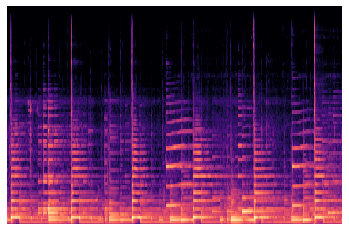

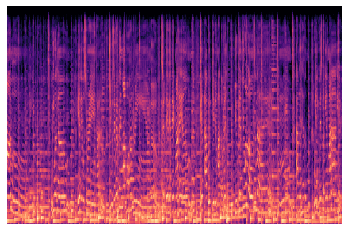

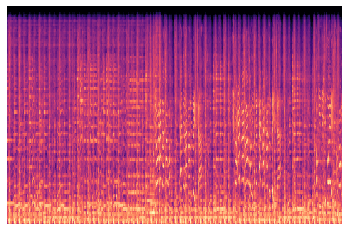

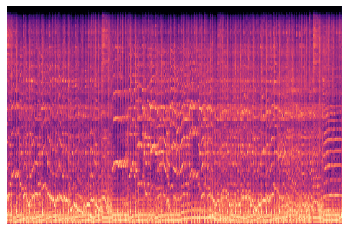

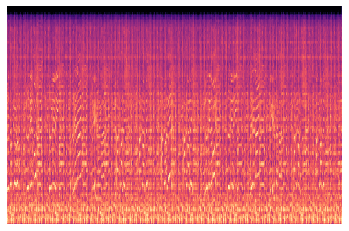

...

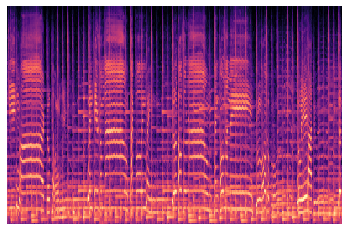

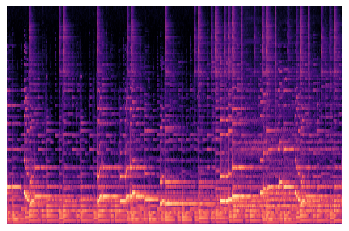

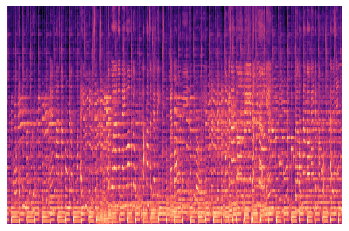

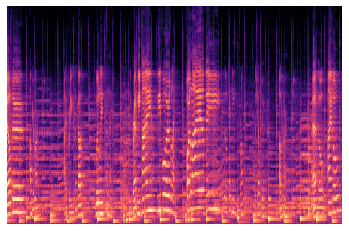

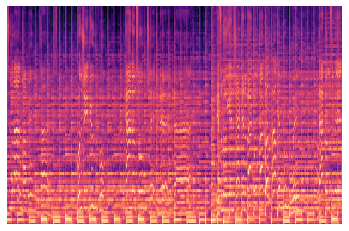

: 

: 

In [45]:
#print(signals[:5])
path = "/Users/kemalcankucuk/Library/CloudStorage/OneDrive-KocUniversitesi/Okul/4. Sınıf/1. Dönem/COMP411/Project/comp411-project/gtzan_dataset/images_custom/"
for i in tqdm(range(len(signals))):
    signal = signals[i]
    filename = signal[0] + str(i % 100)
    extract_melspectrogram(signal[1], filename=path+filename)


/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/librosa/display.py:862: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/librosa/display.py:862: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


[Text(0.5, 1.0, 'Mel Spectrogram Plot')]

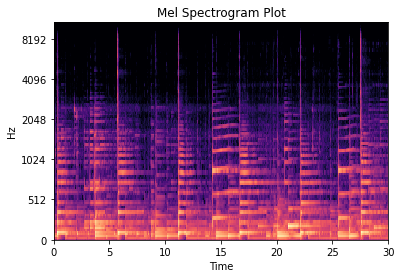

In [26]:
fig, ax = plt.subplots()
mspc = lrf.melspectrogram(y=signals[0][1], sr=SR)
img = lr.display.specshow(lr.power_to_db(mspc, ref=np.max), y_axis='mel', x_axis='time', ax=ax)
ax.set(title='Mel Spectrogram Plot')
#fig.colorbar(img, ax=ax, format="%+2.f dB")
